# Idea
* Determine trading possibilities 
* make them dependent on RTE and possibly other parameters (Avg SoC, max DoD,...)
* determine aging costs using empirical function
* include aging costs in trading decision 


In [1]:
from pandas import read_csv
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

In [2]:
d = read_csv('Day-ahead Prices_202201010000-202301010000.csv')
 
df = d.values
print(df)

[['01.01.2022 00:00 - 01.01.2022 00:15' 69.17 'EUR' nan]
 ['01.01.2022 00:15 - 01.01.2022 00:30' 35.61 'EUR' nan]
 ['01.01.2022 00:30 - 01.01.2022 00:45' 23.14 'EUR' nan]
 ...
 ['31.12.2022 23:15 - 31.12.2022 23:30' 4.94 'EUR' nan]
 ['31.12.2022 23:30 - 31.12.2022 23:45' -2.59 'EUR' nan]
 ['31.12.2022 23:45 - 01.01.2023 00:00' -29.9 'EUR' nan]]


In [3]:
df = pd.DataFrame(df, index=None)

In [4]:
cols = len(df.axes[1])
df.columns = ['time', 'price', 'currency', 'todelete']

In [5]:
df

,time,price,currency,todelete
0,01.01.2022 00:00 - 01.01.2022 00:15,69.17,EUR,NaN
1,01.01.2022 00:15 - 01.01.2022 00:30,35.61,EUR,NaN
2,01.01.2022 00:30 - 01.01.2022 00:45,23.14,EUR,NaN
3,01.01.2022 00:45 - 01.01.2022 01:00,-3.88,EUR,NaN
4,01.01.2022 01:00 - 01.01.2022 01:15,85.06,EUR,NaN
...,...,...,...,...
35039,31.12.2022 22:45 - 31.12.2022 23:00,-29.91,EUR,NaN
35040,31.12.2022 23:00 - 31.12.2022 23:15,25.35,EUR,NaN
35041,31.12.2022 23:15 - 31.12.2022 23:30,4.94,EUR,NaN
35042,31.12.2022 23:30 - 31.12.2022 23:45,-2.59,EUR,NaN


In [6]:
df.drop(columns = 'todelete')

,time,price,currency
0,01.01.2022 00:00 - 01.01.2022 00:15,69.17,EUR
1,01.01.2022 00:15 - 01.01.2022 00:30,35.61,EUR
2,01.01.2022 00:30 - 01.01.2022 00:45,23.14,EUR
3,01.01.2022 00:45 - 01.01.2022 01:00,-3.88,EUR
4,01.01.2022 01:00 - 01.01.2022 01:15,85.06,EUR
...,...,...,...
35039,31.12.2022 22:45 - 31.12.2022 23:00,-29.91,EUR
35040,31.12.2022 23:00 - 31.12.2022 23:15,25.35,EUR
35041,31.12.2022 23:15 - 31.12.2022 23:30,4.94,EUR
35042,31.12.2022 23:30 - 31.12.2022 23:45,-2.59,EUR


<AxesSubplot:>

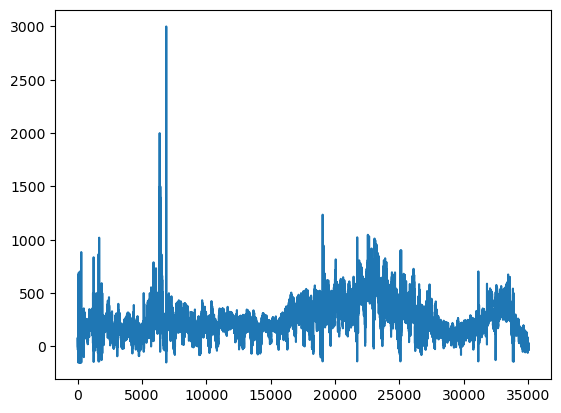

In [7]:
df['price'].plot.line()

In [8]:
df['mean_price']=df['price'].rolling(window=8).mean()

In [9]:
fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=df['time'], y=df['price'], name='price',
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=df['time'], y=df['mean_price'], name = 'mean price',
                         line=dict(color='royalblue', width=4)))

In [10]:
init_energy = np.zeros((len(df),1))
init_buy = np.zeros((len(df),1))
init_sell = np.zeros((len(df),1))
init_etp = np.zeros((len(df),1))
init_soh = np.zeros((len(df),1))


init_energy[0]=5
init_soh[0]=1

In [11]:
df_bat = pd.DataFrame(init_energy, columns = ['energy'], index = df['time'])
df_bat['buy'] = init_buy
df_bat['sell'] = init_sell
df_bat['etp'] = init_etp
df_bat['soh'] = init_soh

#df_bat['energy']
RTE = 0.98*0.98*0.95
power = 5
energy_nom = 10
RTE

0.9123799999999999

In [12]:
buying_index = 0
soc_ul=0.9
soc_ll=0.1
Temp = 25 
duration = 1/(4*24) # 15mins
beta = 0.002 # cyclic aging factor  
alpha = 0.0004 # calendaric aging factor 
cal_exp = 0.75 # calendaric aging exponent 
lifetime = 10
eol = 0.7
v_nom = 3.8 # Volt 
price_difference_factor = 0.2
cycles_per_year = 350
capa_loss_year_allowed_percent = (1-eol)/lifetime
investment_costs_energy = 500 * energy_nom * 1000 # $ 
capa_loss_costs = investment_costs_energy / (capa_loss_year_allowed_percent * energy_nom * 1000) # $ / kWh
energy_tp_lf = cycles_per_year * lifetime * 2 * energy_nom # MWh 

Schmalsteig et al (2014): A holistic aging model for Li(NiMnCo)O2 based 18650 lithium-ion batteries

In [13]:
for i in (df.index):
    if i == 0: 
        df_bat['energy'][i]    
        #print(i)
    # selling - with a focus on high SOC levels
    elif (df_bat['energy'].rolling(window=16).mean().iloc[(i)] >= (soc_ul*0.99) and 
          df['price'][i]*(1-price_difference_factor)>=(df['mean_price'][i-1]/RTE) and 
          df_bat['energy'][i-1]/energy_nom >= soc_ll):
        df_bat['energy'][i] = (-power/4/RTE) + df_bat['energy'][i-1]
        df_bat['sell'][i] = df['price'][i]*power/4/RTE
        df_bat['etp'][i]=df_bat['etp'][i-1]+(power/4/RTE)
        #
        capa_loss = beta * abs((df_bat['energy'][i]- df_bat['energy'][i-1]))/v_nom/1000
        df_bat['soh'][i]=df_bat['soh'][i-1]-capa_loss/energy_nom
        #
    # selling - when selling price is higher than last buying price
    elif (# df['price'][i]>=(df['mean_price'][i-1]/RTE) and 
          df_bat['energy'][i-1]/energy_nom >= soc_ll and 
          df['price'][i]>=(df['price'][buying_index]/RTE) and 
          buying_index != 0):
        df_bat['energy'][i] = (-power/4/RTE + df_bat['energy'][i-1])
        df_bat['sell'][i] = df['price'][i]*power/4/RTE
        df_bat['etp'][i]=df_bat['etp'][i-1]+(power/4/RTE)
        #
        capa_loss = beta * abs((df_bat['energy'][i]- df_bat['energy'][i-1]))/v_nom/1000
        df_bat['soh'][i]=df_bat['soh'][i-1]-capa_loss/energy_nom
        #print('larger')
    # buying - buying when mean price is higher than current price
    elif (df['price'][i]*(1+price_difference_factor)< (df['mean_price'][i-1]/RTE) and 
          df_bat['energy'][i-1]/energy_nom <= soc_ul):
        df_bat['energy'][i] = (power/4/RTE) + df_bat['energy'][i-1]
        df_bat['buy'][i] = df['price'][i]*(power/4/RTE)
        df_bat['etp'][i]=df_bat['etp'][i-1]+(power/4/RTE)
        buying_index = i
        #
        capa_loss = beta * abs((df_bat['energy'][i]- df_bat['energy'][i-1]))/v_nom/1000
        df_bat['soh'][i]=df_bat['soh'][i-1]-capa_loss/energy_nom
        #print('smaller')
    # nothing
    elif (df['price'][i]< df['price'][i-1]/RTE and 
          df_bat['energy'][i-1]/energy_nom >= soc_ul):
        df_bat['energy'][i] = df_bat['energy'][i-1]
        df_bat['etp'][i]=df_bat['etp'][i-1]
        #
        capa_loss = alpha * duration**(cal_exp)
        df_bat['soh'][i]=df_bat['soh'][i-1]-capa_loss/energy_nom
        #print('equal')
    # nothing
    elif (df['price'][i]>=df['price'][i-1]/RTE and 
          df_bat['energy'][i-1]/energy_nom <= soc_ll):
        df_bat['energy'][i] = df_bat['energy'][i-1]
        df_bat['etp'][i]=df_bat['etp'][i-1]
        #
        capa_loss = alpha * duration**(cal_exp)
        df_bat['soh'][i]=df_bat['soh'][i-1]-capa_loss/energy_nom
        #print('equal')
    # nothing
    else:
        df_bat['energy'][i] = df_bat['energy'][i-1]
        df_bat['etp'][i]=df_bat['etp'][i-1]
        #
        capa_loss = alpha * duration**(cal_exp)
        df_bat['soh'][i]=df_bat['soh'][i-1]-capa_loss/energy_nom

#### Cycles per day

In [14]:
df_bat['etp'][-1]/(2*energy_nom)/365

3.4951115357777356

In [15]:
df_bat['sell_cum'] = df_bat['sell'].cumsum()
df_bat['buy_cum'] = df_bat['buy'].cumsum()


In [16]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
#fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=df['time'], y=df_bat['energy'], name='Energy',
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=df['time'], y=df['price'], name='price',
                         line=dict(color='blue', width=4)),
                secondary_y=True,)

#### Evolution of sales and income 

In [17]:
fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=df['time'], y=df_bat['sell_cum'], name='selling',
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=df['time'], y=df_bat['buy_cum'], name='buying',
                         line=dict(color='blue', width=4)))

#### relative income per installed kW

In [18]:
(df_bat['sell_cum'][-1] - df_bat['buy_cum'][-1]) / (power*1e3) # EUR / kW

115.08715392709169

In [19]:
df['hourstime']=df['time'].str[11:16]

In [20]:
df['hourtime']=df['time'].str[11:13].astype(float)

In [21]:
fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=df['time'], y=df_bat['soh'], name='SOH',
                         line=dict(color='firebrick', width=4)))

In [22]:
fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=df['time'], y=df_bat['energy'].rolling(window=16).mean(), name='mean SoC',
                         line=dict(color='firebrick', width=4)))